In [60]:
from wrangler import Wrangler
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
from PIL import Image, ImageOps
from matplotlib.animation import FuncAnimation, writers
from shapely.geometry import Point, Polygon, LineString

In [2]:
nndf = Wrangler.load_pickle('data/nndf.pkl')

In [14]:
all_df = Wrangler.load_pickle('data/all_df.pkl')
l_df = pd.read_csv('bsc-3m/signals_dense.csv')
l_xy = Wrangler.load_pickle('bsc-3m/signal_lines_true.pickle')

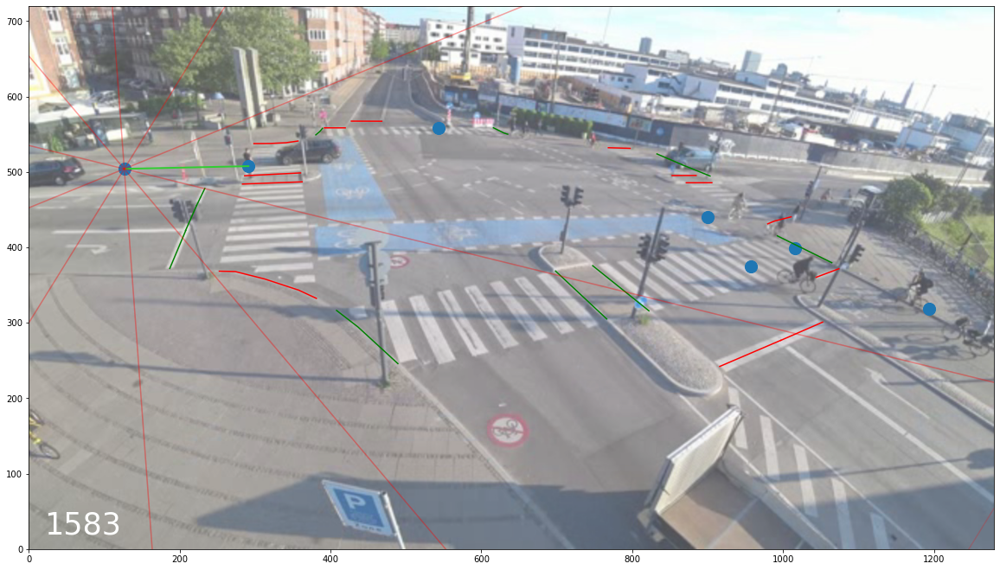

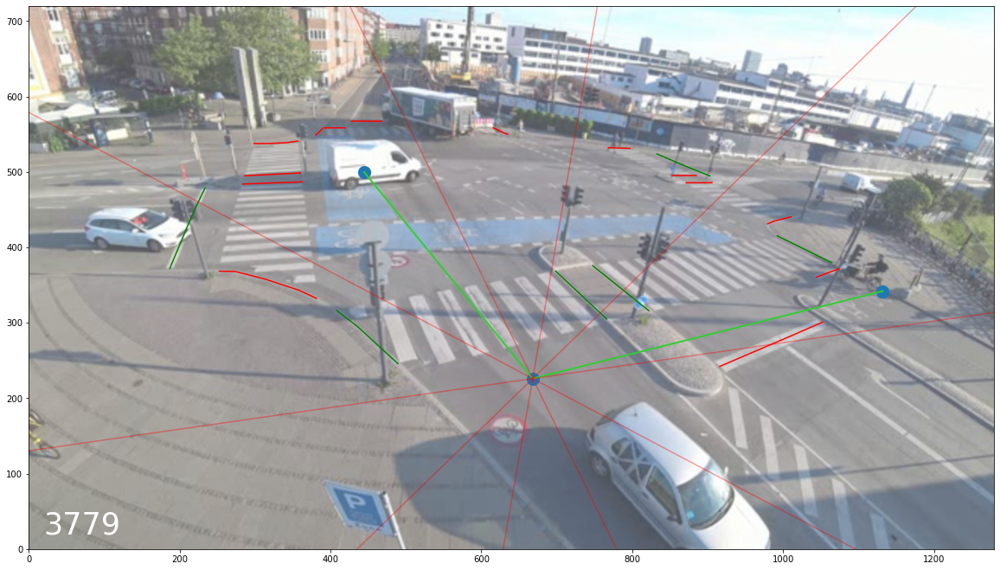

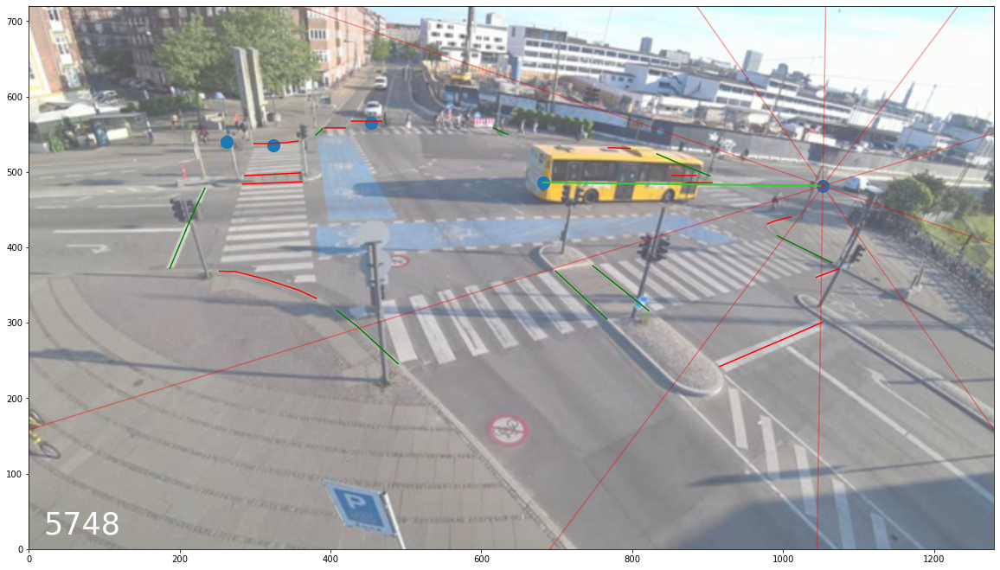

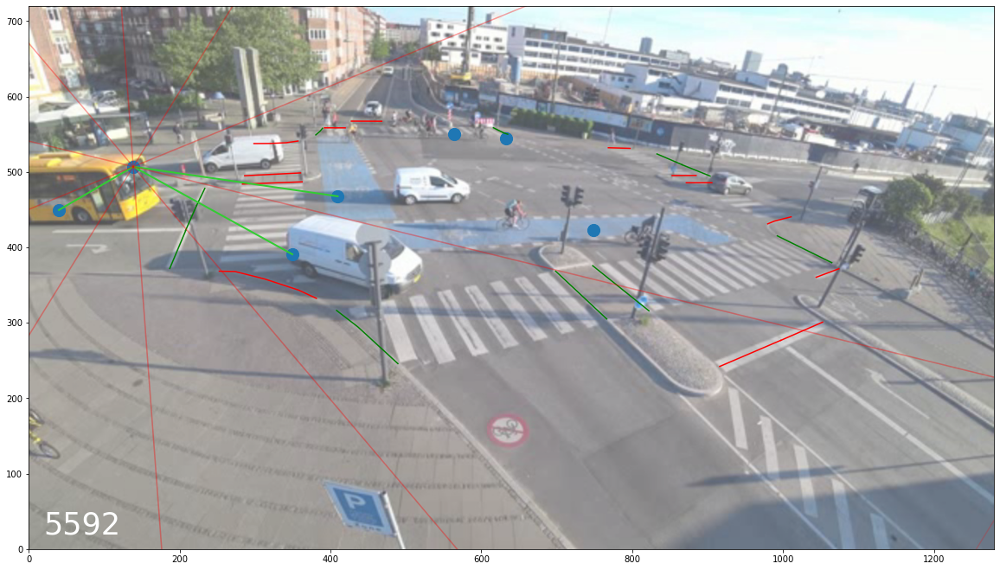

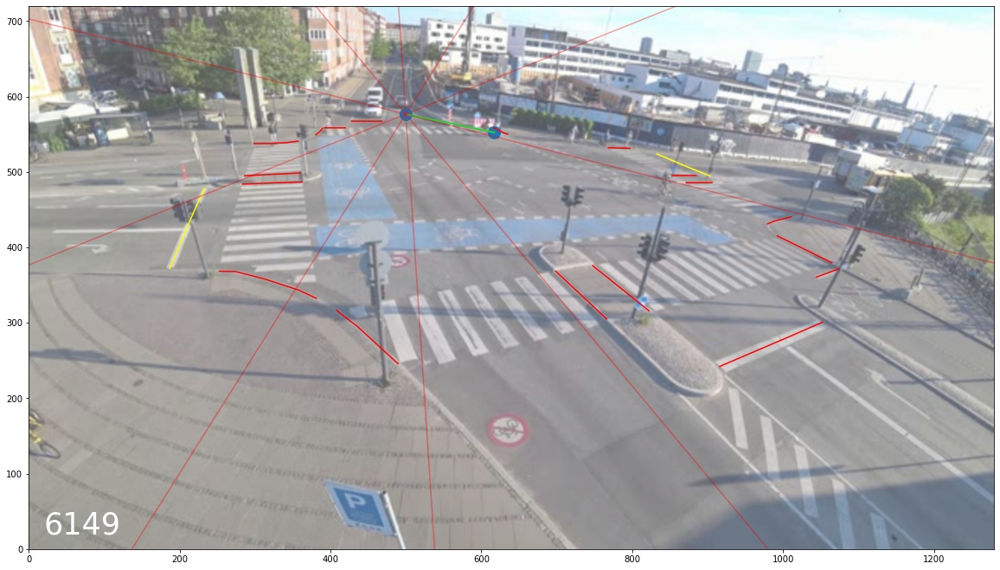

...

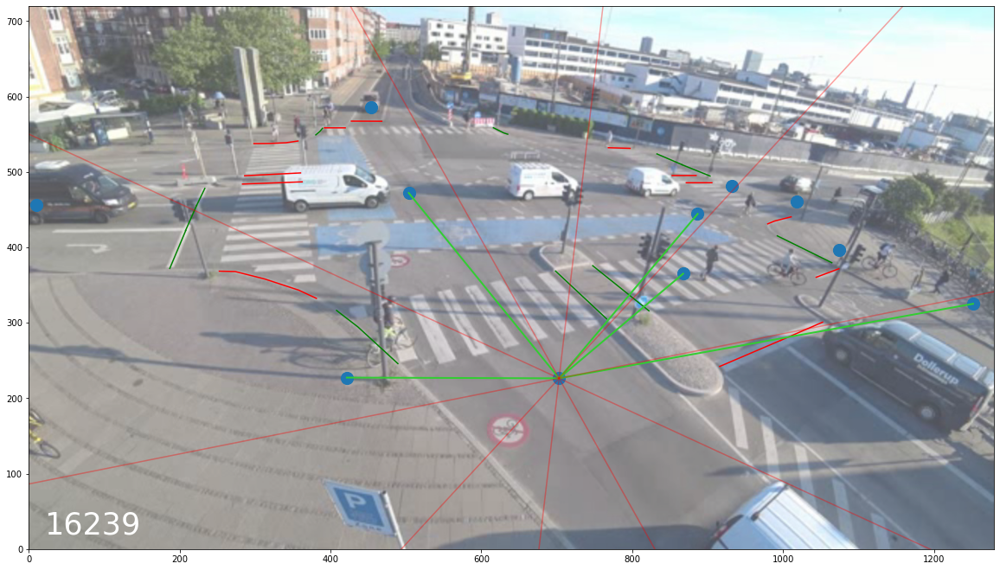

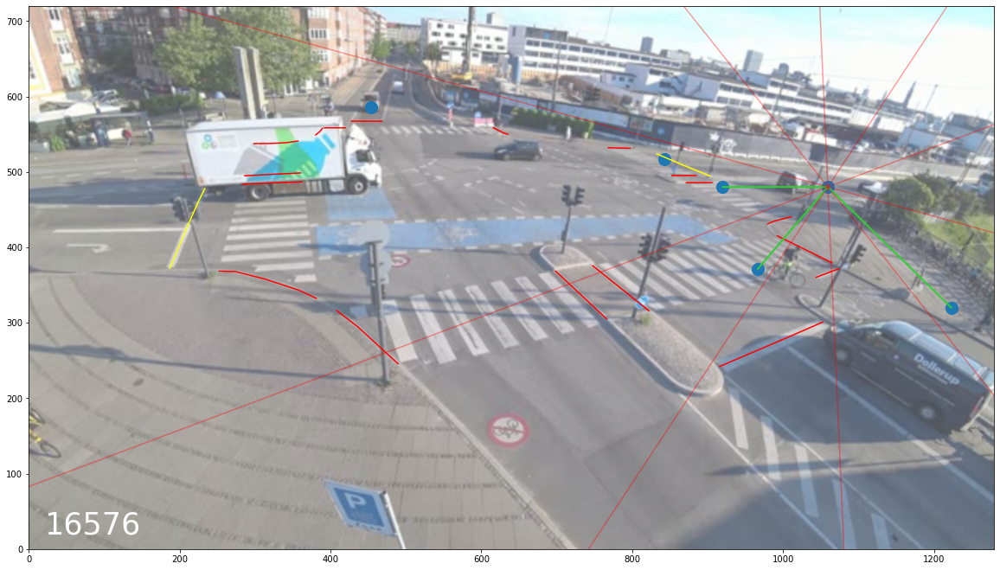

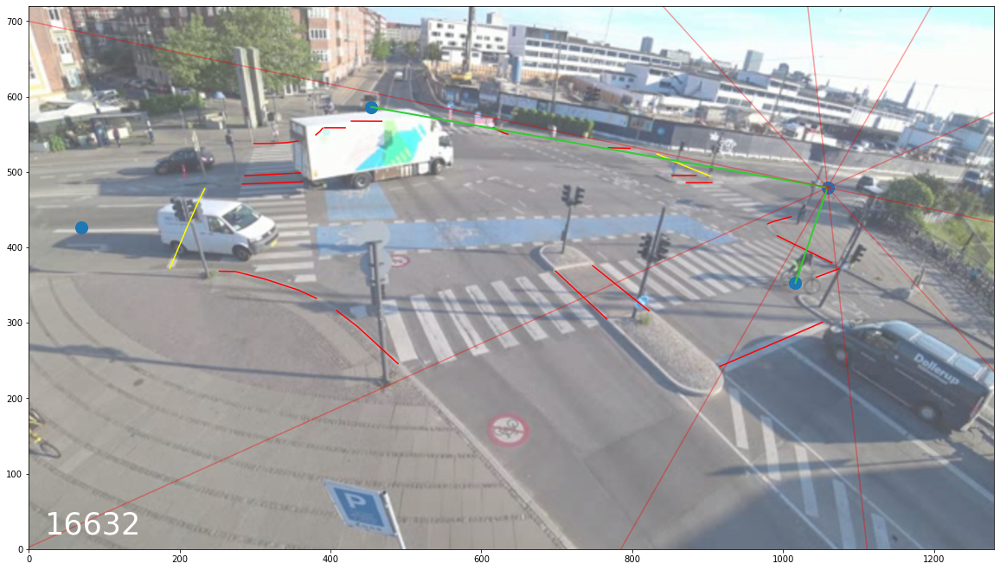

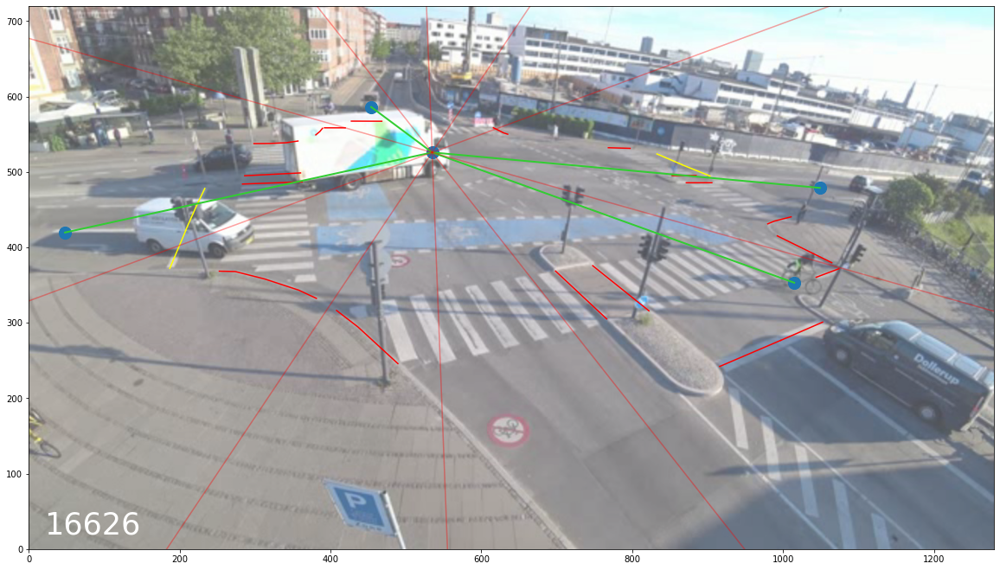

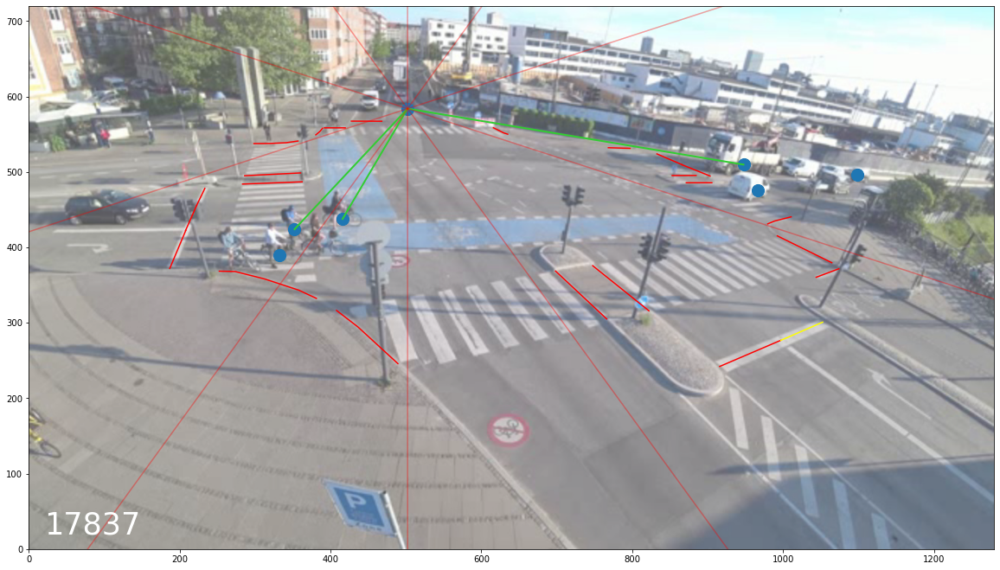

In [69]:
for index in range(20):
    frames = list(nndf[nndf['index']==index]['frame'])

    # create figure
    fig, ax = plt.subplots(figsize=(20, 20))
    ax.set_xlim(0, 1280)
    ax.set_ylim(0, 720)
    img = Image.open("intersection2.png")
    img = ImageOps.flip(img)

    # create patches, to be animated objects
    im = ax.imshow(img, origin='lower', alpha=.7)
    ln = [ax.plot([], [])[0] for _ in range(l_df.shape[-1] - 1)]
    txt = ax.text(20, 20, '', fontsize=35, color='w')
    sc = ax.scatter([], [], s=200)
    zones = [ax.plot([], [], color='limegreen', linewidth=2)[0] for _ in range(10)]
    zones_zones = [ax.plot([], [], color='red', alpha=.2)[0] for _ in range(10)]
    patches = ln + [sc] + [txt] + [im]

    # animation init func, initializes all light lines
    def init():
        for i in range(len(ln)):
            ln[i].set_data(l_xy[i]['x'], l_xy[i]['y'])
        return patches

    # animation update func, run this func to each frame
    def update(frame):
        # update all light lines to current light color
        row = l_df.loc[frame]
        for i in range(l_df.shape[1] - 1):
            ln[i].set_color(['red', 'orange', 'yellow', 'green'][row[str(i)]])

        # update frame counter
        txt.set(text=str(frame))

        # update all current object positions and colors
        mask = all_df['frame'] == frame
        xy = all_df.loc[mask][['x', 'y']].to_numpy()
        sc.set_offsets(xy)
        # sc.set(color=[class_color[row['class']] for _, row in all_df.loc[mask].iterrows()])

        # update current image
        img = Image.open('frames/frame' + str(frame) + '.jpg')  # + pic_frames[frame])
        img = ImageOps.flip(img)
        im.set_array(img)

        mask = (nndf['frame'] == frame) & (nndf['index'] == index)
        for i in range(10):
            col = f'zone_{i}'
            zx, zy = list(nndf.loc[mask, col])[0].exterior.xy
            zones_zones[i].set_data(zx, zy)
            p_0 = Point([list(nndf[mask]['x'])[0], list(nndf[mask]['y'])[0]])
            zone = list(nndf.loc[mask, col])[0]
            closest_point = None
            dist = 10000
            for _, row in all_df[all_df['frame']==frame].iterrows():
                p = Point([row['x'], row['y']])
                if zone.contains(p) and p_0.distance(p) <= dist:
                    closest_point = p
                    dist = p_0.distance(p)
            if closest_point is not None:
                line = LineString([p_0, closest_point])
                lx, ly = line.xy
                zones[i].set_data(lx,ly)
            else:
                zones[i].set_data([], [])


        return patches

    # create animation
    mpl.rcParams['animation.ffmpeg_path'] = r'D:\ffmpeg\bin\ffmpeg.exe'
    ani = FuncAnimation(fig, update, frames=frames,  # run animation from frame 0 to frame 3000
                        init_func=init)

    Writer = writers['ffmpeg']
    writer = Writer(fps=6)
    ani.save(f'zone_lines_{index}.mp4', writer)